In [2]:
import numpy as np 
import pandas as pd 
import seaborn as sns 
import matplotlib.pyplot as plt

from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler, normalize
from scipy.signal import savgol_filter  

In [6]:
train = pd.read_csv('..\\..\\Data\\exoTrain.csv')
test = pd.read_csv('..\\..\\Data\\exoTest.csv')
train.head()

,LABEL,FLUX.1,FLUX.2,FLUX.3,FLUX.4,FLUX.5,FLUX.6,FLUX.7,FLUX.8,FLUX.9,...,FLUX.3188,FLUX.3189,FLUX.3190,FLUX.3191,FLUX.3192,FLUX.3193,FLUX.3194,FLUX.3195,FLUX.3196,FLUX.3197
0,2,93.85,83.81,20.10,-26.98,-39.56,-124.71,-135.18,-96.27,-79.89,...,-78.07,-102.15,-102.15,25.13,48.57,92.54,39.32,61.42,5.08,-39.54
1,2,-38.88,-33.83,-58.54,-40.09,-79.31,-72.81,-86.55,-85.33,-83.97,...,-3.28,-32.21,-32.21,-24.89,-4.86,0.76,-11.70,6.46,16.00,19.93
2,2,532.64,535.92,513.73,496.92,456.45,466.00,464.50,486.39,436.56,...,-71.69,13.31,13.31,-29.89,-20.88,5.06,-11.80,-28.91,-70.02,-96.67
3,2,326.52,347.39,302.35,298.13,317.74,312.70,322.33,311.31,312.42,...,5.71,-3.73,-3.73,30.05,20.03,-12.67,-8.77,-17.31,-17.35,13.98
4,2,-1107.21,-1112.59,-1118.95,-1095.10,-1057.55,-1034.48,-998.34,-1022.71,-989.57,...,-594.37,-401.66,-401.66,-357.24,-443.76,-438.54,-399.71,-384.65,-411.79,-510.54


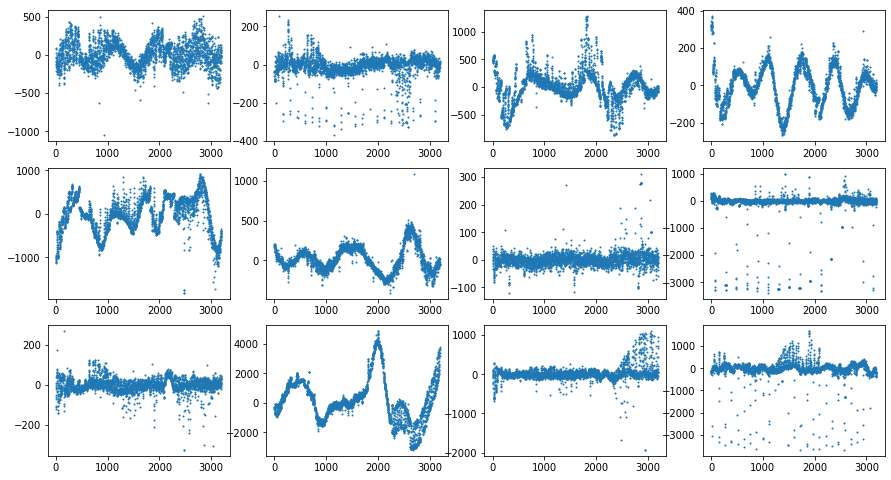

In [4]:
# Stars with exoplanets
fig = plt.figure(figsize=(15,40))
for i in range(12):
    ax = fig.add_subplot(14,4,i+1)
    ax.scatter(np.arange(3197),train[train['LABEL'] == 2].iloc[i,1:],s=1)


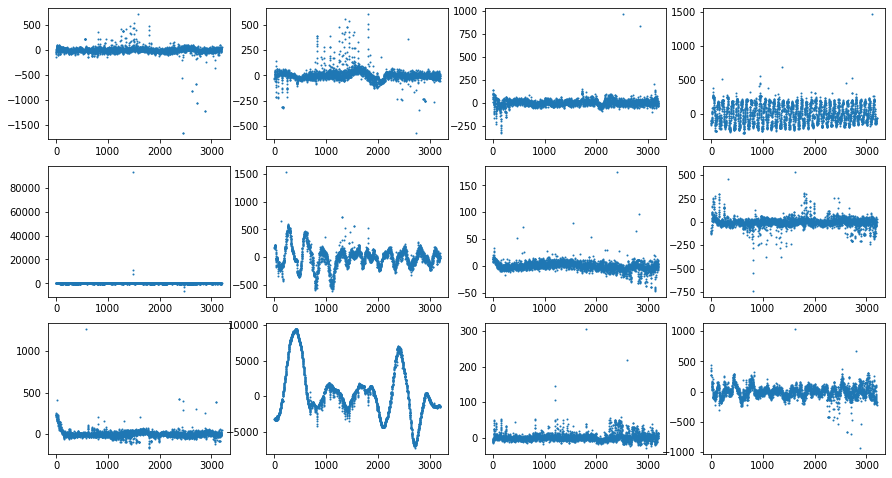

In [5]:
# stars without exoplanets

fig = plt.figure(figsize=(15,40))
for i in range(12):
    ax = fig.add_subplot(14,4,i+1)
    ax.scatter(np.arange(3197),train[train['LABEL']==1].iloc[i,1:],s=1)

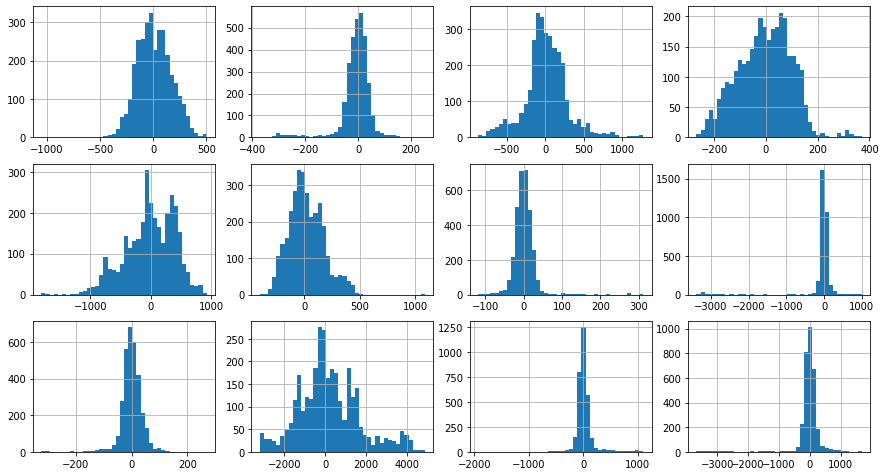

In [23]:
# Histogram of Stars with Exoplanets

fig = plt.figure(figsize=(15,40))
for i in range(12):
    ax = fig.add_subplot(14,4,i+1)
    train[train['LABEL']==2].iloc[i,1:].hist(bins=40)

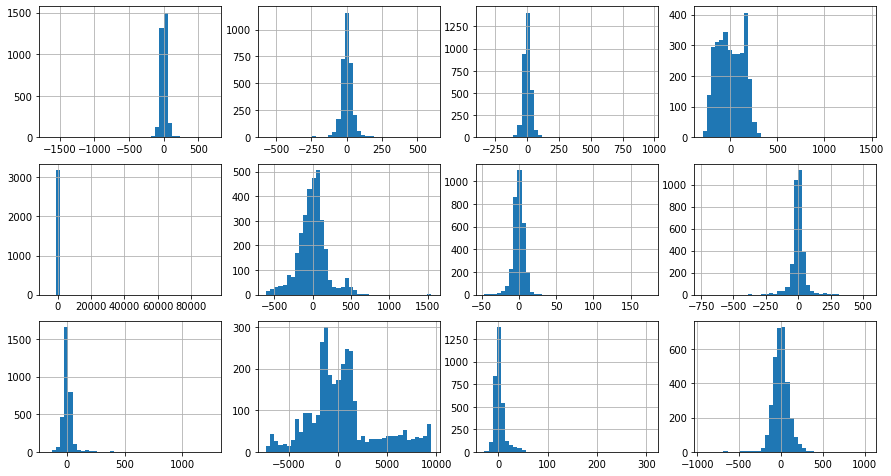

In [24]:
# Histogram of Stars without Exoplanets

fig = plt.figure(figsize=(15,40))
for i in range(12):
    ax = fig.add_subplot(14,4,i+1)
    train[train['LABEL']==1].iloc[i,1:].hist(bins=40)

In [25]:
# Range of maximum and minimum values.

maxval = train.iloc[:,1:].max(axis=1)
minval = train.iloc[:,1:].min(axis=1)

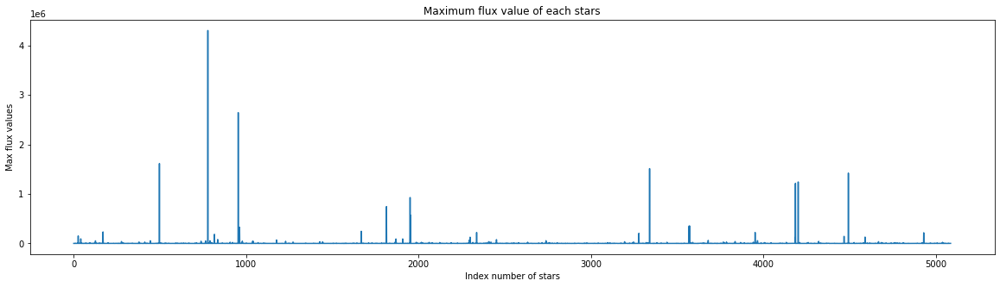

In [26]:
plt.figure(figsize=(20,5))
plt.title('Maximum flux value of each stars')
plt.xlabel('Index number of stars')
plt.ylabel('Max flux values')
plt.plot(np.arange(len(maxval)),maxval)

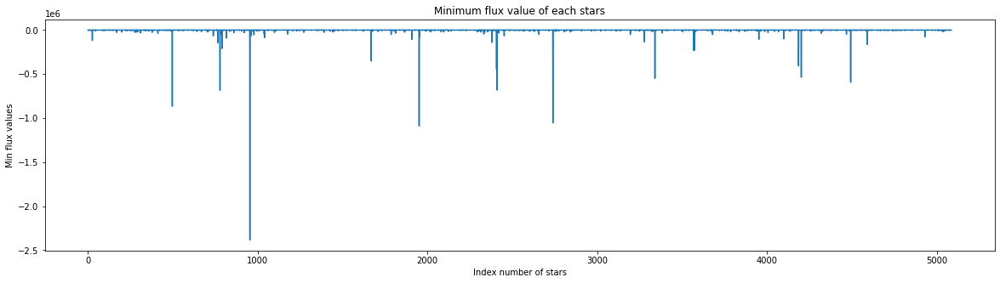

In [27]:
plt.figure(figsize=(20,5))
plt.title('Minimum flux value of each stars')
plt.xlabel('Index number of stars')
plt.ylabel('Min flux values')
plt.plot(np.arange(len(minval)),minval)

In [28]:
# Data Pre Processing

In [29]:
def reset(train,test):
    train_X = train.drop('LABEL', axis=1)
    train_y = train['LABEL'].values
    test_X = test.drop('LABEL', axis=1)
    test_y = test['LABEL'].values
    return train_X,train_y,test_X,test_y

train_X,train_y,test_X,test_y = reset(train,test)

In [30]:
def robust(df1,df2):
    scaler = RobustScaler()
    train_X = scaler.fit_transform(df1)
    test_X = scaler.transform(df2)
    return train_X,test_X

In [31]:
def std_scaler(df1,df2):
    std_scaler = StandardScaler()
    train_X = std_scaler.fit_transform(df1)
    test_X = std_scaler.fit_transform(df2)
    return train_X,test_X

In [32]:
def norm(df1,df2):
    train_X = normalize(df1)
    test_X = normalize(df2)
    return train_X,test_X

In [33]:
def fourier(df1,df2):
    train_X = np.abs(np.fft.fft(df1, axis=1))
    test_X = np.abs(np.fft.fft(df2, axis=1))
    return train_X,test_X

In [34]:
def savgol(df1,df2):
    x = savgol_filter(df1,21,4,deriv=0)
    y = savgol_filter(df2,21,4,deriv=0)
    return x,y

In [35]:
def smote(a,b):
    model = SMOTE()
    X,y = model.fit_sample(a, b)
    return X,y

In [36]:
# Feature Engineering and Visualzation

In [37]:
train_X,train_y,test_X,test_y = reset(train,test)
a,b = fourier(train_X,test_X)
c,d = savgol(a,b)
e,f = norm(c,d)
g,h = robust(e,f)

In [41]:
#index 0-37 contains stars with exoplanets and the rest are stars with no exoplanets
planets = [0,1,2,3,4,91,92,97]

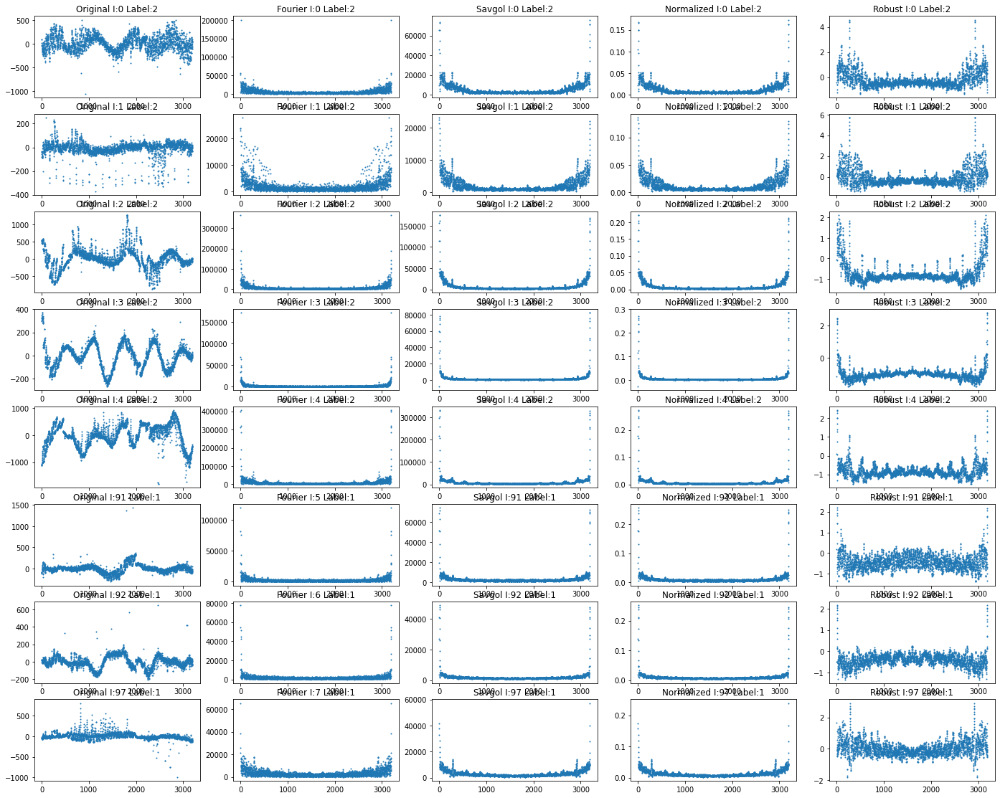

In [42]:
fig = plt.figure(figsize=(24,250))
x = np.array(range(3197))
for i in range(0,len(planets)):
    ax = fig.add_subplot(100,5,5*i+1)
    ax.set_title('Original '+"I:"+str(planets[i])+" Label:"+str(train_y[planets[i]]))
    ax.scatter(x,train_X.iloc[planets[i],:],s=1)
    
    ax = fig.add_subplot(100,5,5*i+2)
    ax.set_title('Fourier '+"I:"+str(i)+" Label:"+str(train_y[planets[i]]))
    ax.scatter(x,a[planets[i],:],s=1)
    
    ax = fig.add_subplot(100,5,5*i+3)
    ax.set_title('Savgol '+"I:"+str(planets[i])+" Label:"+str(train_y[planets[i]]))
    ax.scatter(x,c[planets[i],:],s=1)
    
    ax = fig.add_subplot(100,5,5*i+4)
    ax.set_title('Normalized '+"I:"+str(planets[i])+" Label:"+str(train_y[planets[i]]))
    ax.scatter(x,e[planets[i],:],s=1)
    
    ax = fig.add_subplot(100,5,5*i+5)
    ax.set_title('Robust '+"I:"+str(planets[i])+" Label:"+str(train_y[planets[i]]))
    ax.scatter(x,g[planets[i],:],s=1)    